In [1]:
from pathlib import Path

import pandas as pd
import numpy as np
import datetime as dt

import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
import seaborn as sns

from ray import tune
from ray.air import session
from ray.train import Checkpoint

from recsys4daos.utils.notebooks import download_plotly, download_matplotlib
import paths

pio.templates.default = 'seaborn'
sns.set_theme()

In [2]:
SPLITS_FREQ = 'W-THU'
SPLITS_NORMALIZE = True # Wether or not to move everything to 00:00
CUTOFF_DATE = dt.datetime.fromisoformat("2023-07-29")
RAY_RESULTS_PATH = '~/ray_results3.11'
ORG_NAME = 'Decentraland'
LAST_FOLDS = 10 # Used for asserts
LAST_FOLD_DATE_STR: str = '2023-07-13'

OPTIM_METRIC = 'map@10'
OPTIM_MODE = 'max'

SAMPLES_PER_SPLIT: int = 100 # See 07_microsoft_tuning.ipynb

In [3]:
# Parameters
EXECUTION_ID = "2024-09-04T10:00"
MIN_BATCH_SIZE = 4
ORG_NAME = "Aura Finance"
SPLITS_FREQ = "7d"
LAST_FOLDS = 10
SPLITS_NORMALIZE = True
LAST_FOLD_DATE_STR = "2023-07-14"


In [4]:
RAY_RESULTS_PATH = Path(RAY_RESULTS_PATH).expanduser()
assert RAY_RESULTS_PATH.is_dir()

## Get ray results

In [5]:
fname_glob = paths.lightgcn_ray_tune_fname(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, OPTIM_METRIC, fold='glob')
fname_glob

'Aura Finance/LightGCN_7d_normalize_map@10_fold=[0-9]*'

In [6]:
last_experiments = sorted(RAY_RESULTS_PATH.glob(fname_glob))
print(f"Found {len(last_experiments)} folds")

class TrainLightGCN:
    def __init__(self):
        raise NotImplementedError

tuners = [ tune.Tuner.restore(str(l), TrainLightGCN) for l in last_experiments ]
result_grids = [ tuner.get_results() for tuner in tuners ]
assert len(result_grids) == LAST_FOLDS, f"Waiting for full experiment to run {len(result_grids)}/{LAST_FOLDS}"

for i, rg in enumerate(result_grids):
    print(f"Fold: {i}, {rg.num_terminated} finished, {rg.num_errors} errors")
    assert rg.num_terminated == SAMPLES_PER_SPLIT
    assert rg.num_errors == 0, "There should be no errors"

Found 10 folds


Fold: 0, 100 finished, 0 errors
Fold: 1, 100 finished, 0 errors
Fold: 2, 100 finished, 0 errors
Fold: 3, 100 finished, 0 errors
Fold: 4, 100 finished, 0 errors
Fold: 5, 100 finished, 0 errors
Fold: 6, 100 finished, 0 errors
Fold: 7, 100 finished, 0 errors
Fold: 8, 100 finished, 0 errors
Fold: 9, 100 finished, 0 errors


In [7]:
# Checking data from just one experiment
pd.concat(result_grids[0]._experiment_analysis.trial_dataframes.values())

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,node_ip,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,150,5,0.692679,0.692679,1.056880e-08,0.007353,0.058824,0.058824,0.058824,0.352941,...,147.96.81.131,0.443861,1,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00
1,150,10,0.690831,0.690831,1.317313e-08,0.007353,0.058824,0.058824,0.058824,0.352941,...,147.96.81.131,0.667602,2,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00
2,150,15,0.685434,0.685434,1.708068e-08,0.007353,0.058824,0.058824,0.058824,0.352941,...,147.96.81.131,0.878709,3,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00
3,150,20,0.675574,0.675574,2.451436e-08,0.026961,0.117647,0.117647,0.117647,0.352941,...,147.96.81.131,1.159377,4,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00
4,150,25,0.662409,0.662409,3.405367e-08,0.026961,0.117647,0.117647,0.117647,0.352941,...,147.96.81.131,1.404116,5,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,150,180,0.102482,0.102469,1.289538e-05,0.007353,0.058824,0.058824,0.058824,0.294118,...,147.96.81.131,8.156124,36,9,4,3,0.0028,1.061547e-06,60d,2023-05-12T00:00:00
36,150,185,0.103227,0.103214,1.315990e-05,0.007353,0.058824,0.058824,0.058824,0.294118,...,147.96.81.131,8.373135,37,9,4,3,0.0028,1.061547e-06,60d,2023-05-12T00:00:00
37,150,190,0.082224,0.082211,1.330930e-05,0.007353,0.058824,0.058824,0.058824,0.294118,...,147.96.81.131,8.585097,38,9,4,3,0.0028,1.061547e-06,60d,2023-05-12T00:00:00
38,150,195,0.085887,0.085873,1.340116e-05,0.007353,0.058824,0.058824,0.058824,0.352941,...,147.96.81.131,8.824241,39,9,4,3,0.0028,1.061547e-06,60d,2023-05-12T00:00:00


## Create dataframe with all results

In [8]:
# Read dataframe and drop some unneeded columns
# rdf = pd.concat([rg.get_dataframe(TARGET, 'max') for rg in result_grids ])
rdf = pd.concat([ pd.concat(rg._experiment_analysis.trial_dataframes.values()) for rg in result_grids ])

drop_cols = [
    'timestamp', 'node_ip', 'pid', 'hostname', 'time_since_restore', # 'checkpoint_dir_name', 'trial_id', # 'logdir'
    'model_recall', 'model_ndcg', 'model_precision', 'model_map', 
    'time_train', 'time_eval', 'time_total_s', 'time_this_iter_s',
    'training_iteration', 'iterations_since_restore',
    # 'recall@5', 'map@5', 'recall@10', 'map@10',
]
rdf = rdf.drop(columns=drop_cols)
rdf = rdf.drop(columns=['date']).rename(columns={'config/__trial_index__': 'config/fold', 'iteration':'config/iteration'})
rdf['config/fold'] = pd.to_datetime(rdf['config/fold'])
# rdf = rdf[rdf['done']]
print(rdf.columns)

for c in ['config/batch_size']: #, 'config/embedding_dim']:
    rdf[c] = 2**rdf[c]

# rdf[(rdf['config/fold'] >= 1) & (rdf['iteration'] > 10)].sort_values('precision@5').tail()
# Display some results
rdf.sort_values(OPTIM_METRIC).tail()

Index(['real_batch_size', 'config/iteration', 'loss', 'mf_loss', 'emb_loss',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_rec', 'time_total_train', 'time_total_test', 'done', 'trial_id',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_size',
       'config/fold'],
      dtype='object')


,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
9,16,50,0.369336,0.369335,9.337997e-07,1.000000,0.787879,0.745455,0.481818,0.321212,...,1.259209,False,fdbfafad,16,4,2,0.0002,6.252469e-07,90d,2023-06-30
8,16,45,0.388875,0.388874,8.210642e-07,1.000000,0.787879,0.745455,0.481818,0.321212,...,1.133702,False,fdbfafad,16,4,2,0.0002,6.252469e-07,90d,2023-06-30
12,16,65,0.329994,0.329993,1.251921e-06,1.000000,0.787879,0.745455,0.481818,0.321212,...,1.634158,False,fdbfafad,16,4,2,0.0002,6.252469e-07,90d,2023-06-30
39,16,200,10.414774,2.730236,7.684538e+00,0.916667,0.694444,0.633333,0.358333,0.238889,...,6.082474,True,1f3d6b5f,16,352,1,0.1413,8.250397e-04,10YE,2023-06-09
2,32,15,0.730291,0.727990,2.300904e-03,1.000000,0.666667,0.600000,0.358333,0.238889,...,0.527602,False,585bc050,32,65,1,0.1155,8.831573e-07,10YE,2023-06-09


### Define K_RECOMMENDATIONS

In [9]:
K_RECOMMENDATIONS = { int(c.split('@')[1]) for c in rdf.columns if '@' in c }
K_RECOMMENDATIONS

{1, 3, 5, 10, 15, 100}

## Assert that every experiment was completed

In [10]:
_config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

# _s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
# print(_s)

# Cuidado, no es aleatorio sin reemplazamiento, por lo que
# alguna config, por casualidad, puede estar repetida y es necesario
# usar trial_id
_config_cols.append('trial_id')

_s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
print(_s)
assert all(_s == SAMPLES_PER_SPLIT), "Insufficient number of samples" 

config/fold
2023-05-12    100
2023-05-19    100
2023-05-26    100
2023-06-02    100
2023-06-09    100
2023-06-16    100
2023-06-23    100
2023-06-30    100
2023-07-07    100
2023-07-14    100
dtype: int64


## Get total execution time

In [11]:
_config_cols = ['trial_id'] + [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

last_iteration_time = rdf.groupby(_config_cols)['time_total_train'].max()
print(last_iteration_time)
print("Mean exec time: ", dt.timedelta(seconds=last_iteration_time.mean()))
print("Total exec time:", dt.timedelta(seconds=last_iteration_time.sum()))

trial_id  config/batch_size  config/embedding_dim  config/conv_layers  config/learning_rate  config/l2     config/window_size  config/fold
002121b2  256                1                     3                   0.0049                1.086794e-05  21d                 2023-07-14       2.530443
00492714  256                1                     3                   0.0047                5.312490e-07  60d                 2023-05-12       2.446582
007ef425  64                 1008                  3                   0.0109                2.940847e-03  90d                 2023-07-07       5.502773
01b15036  32                 74                    2                   0.1736                8.637994e-07  10YE                2023-06-30      62.446501
01b1d8a2  256                5                     3                   0.0006                1.130210e-04  30d                 2023-06-16       9.342389
                                                                                                

In [12]:
# Number of iterations
rdf.groupby('trial_id')['config/iteration'].max().describe()

count    1000.000000
mean      199.430000
std         7.076382
min        95.000000
25%       200.000000
50%       200.000000
75%       200.000000
max       200.000000
Name: config/iteration, dtype: float64

## Get baseline data

In [13]:
bdf = paths.load_openpop(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
bdf = bdf[bdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
bdf.mean()

precision@1        0.386743
precision@3        0.243347
precision@5        0.204726
precision@10       0.128325
precision@15       0.087216
precision@100      0.013082
ndcg@1             0.376723
ndcg@3             0.324839
ndcg@5             0.324252
ndcg@10            0.317063
ndcg@15            0.316436
ndcg@100           0.316436
map@1              0.386743
map@3              0.292073
map@5              0.276619
map@10             0.264861
map@15             0.264567
map@100            0.264567
recall@1           0.139751
recall@3           0.218821
recall@5           0.303853
recall@10          0.347796
recall@15          0.350250
recall@100         0.350250
r-precision@1      0.205890
r-precision@3      0.268131
r-precision@5      0.306385
r-precision@10     0.332853
r-precision@15     0.333895
r-precision@100    0.333895
time_eval          0.112550
dtype: float64

In [14]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-12,0.294118,0.098039,0.058824,0.029412,0.019608,0.002941,0.294118,0.138023,0.107407,0.092192,...,0.053431,0.053431,0.053431,0.181667,0.181667,0.181667,0.181667,0.181667,0.181667,0.126327
2023-05-19,0.583333,0.555556,0.566667,0.458333,0.322222,0.048333,0.583333,0.608007,0.699209,0.737214,...,0.949769,0.974306,0.974306,0.264853,0.445238,0.594147,0.755258,0.765675,0.765675,0.128861
2023-05-26,0.153846,0.282051,0.292308,0.146154,0.097436,0.014615,0.153846,0.267724,0.323910,0.274000,...,0.321795,0.321795,0.321795,0.100000,0.261905,0.356250,0.356250,0.356250,0.356250,0.132081
2023-06-02,0.384615,0.589744,0.584615,0.376923,0.251282,0.037692,0.357143,0.585016,0.660655,0.695388,...,0.979396,0.979396,0.979396,0.153571,0.430357,0.569643,0.673214,0.673214,0.673214,0.130645
2023-06-09,0.833333,0.277778,0.166667,0.083333,0.055556,0.008333,0.833333,0.567973,0.502913,0.493774,...,0.425000,0.425000,0.425000,0.510000,0.510000,0.510000,0.510000,0.510000,0.510000,0.129407
2023-06-16,0.818182,0.363636,0.218182,0.109091,0.072727,0.010909,0.818182,0.714194,0.651951,0.610800,...,0.557143,0.557143,0.557143,0.609524,0.612857,0.612857,0.612857,0.612857,0.612857,0.126719
2023-06-23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.073857
2023-06-30,0.800000,0.266667,0.160000,0.080000,0.053333,0.008000,0.727273,0.367452,0.296478,0.267258,...,0.191429,0.191429,0.191429,0.239286,0.239286,0.239286,0.239286,0.239286,0.239286,0.127027
2023-07-07,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.075259


(0.0, 1.0)

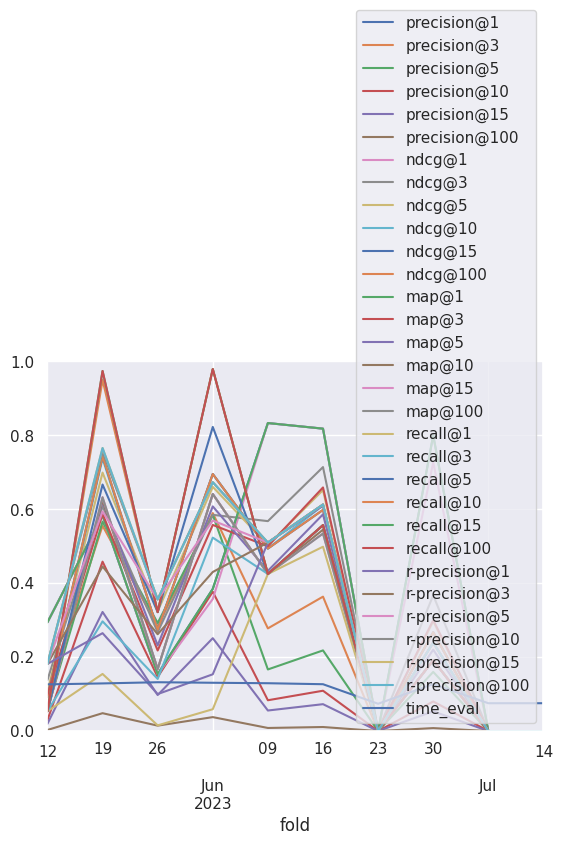

In [15]:
ax = bdf.plot()
ax.set_ylim(0, 1)

### Get perfect data

In [16]:
pdf = paths.load_perfect(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
pdf = pdf[pdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
pdf.mean()

precision@1        1.000000
precision@3        0.752618
precision@5        0.647471
precision@10       0.433554
precision@15       0.304995
precision@100      0.045749
ndcg@1             1.000000
ndcg@3             1.000000
ndcg@5             1.000000
ndcg@10            1.000000
ndcg@15            1.000000
ndcg@100           1.000000
map@1              1.000000
map@3              1.000000
map@5              1.000000
map@10             1.000000
map@15             1.000000
map@100            1.000000
recall@1           0.474676
recall@3           0.719350
recall@5           0.865732
recall@10          0.982775
recall@15          1.000000
recall@100         1.000000
r-precision@1      0.474676
r-precision@3      0.719350
r-precision@5      0.865732
r-precision@10     0.982775
r-precision@15     1.000000
r-precision@100    1.000000
time_eval          0.133159
dtype: float64

In [17]:
pdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-12,1.0,0.568627,0.435294,0.270588,0.180392,0.027059,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.720098,0.866176,0.933824,1.000000,1.0,1.0,0.132610
2023-05-19,1.0,0.722222,0.650000,0.491667,0.338889,0.050833,1.0,1.0,1.0,1.0,...,0.986111,1.0,1.0,0.498247,0.661409,0.803737,0.986111,1.0,1.0,0.133137
2023-05-26,1.0,0.794872,0.646154,0.407692,0.271795,0.040769,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.462821,0.773077,0.910256,1.000000,1.0,1.0,0.131254
2023-06-02,1.0,0.761905,0.628571,0.371429,0.247619,0.037143,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.447704,0.771684,0.917092,1.000000,1.0,1.0,0.133836
2023-06-09,1.0,0.722222,0.666667,0.358333,0.238889,0.035833,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.525000,0.741667,0.958333,1.000000,1.0,1.0,0.130656
2023-06-16,1.0,0.666667,0.581818,0.418182,0.327273,0.049091,1.0,1.0,1.0,1.0,...,0.948052,1.0,1.0,0.557143,0.716883,0.831169,0.948052,1.0,1.0,0.135280
2023-06-23,1.0,0.969697,0.909091,0.718182,0.478788,0.071818,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.181061,0.497727,0.723485,1.000000,1.0,1.0,0.134768
2023-06-30,1.0,0.878788,0.781818,0.481818,0.321212,0.048182,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.313420,0.667532,0.870130,1.000000,1.0,1.0,0.131084
2023-07-07,1.0,0.607843,0.435294,0.217647,0.145098,0.021765,1.0,1.0,1.0,1.0,...,1.000000,1.0,1.0,0.696078,0.911765,1.000000,1.000000,1.0,1.0,0.133514


(0.0, 1.0)

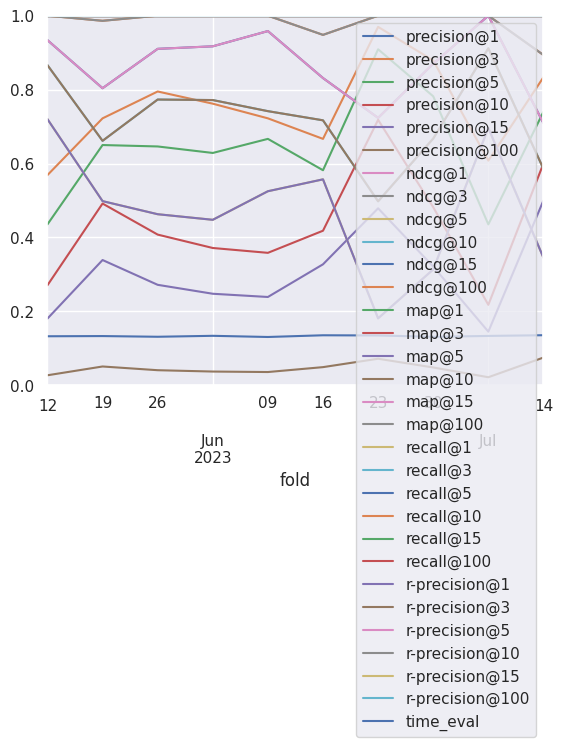

In [18]:
ax = pdf.plot()
ax.set_ylim(0, 1)

## Explore hparams

In [19]:
# Primero, obtenemos la mejor iteración, como si hubiesemos hecho early stopping
hdf = pd.concat(rg.get_dataframe(OPTIM_METRIC, OPTIM_MODE) for rg in result_grids)
print(hdf.columns)
hdf

Index(['real_batch_size', 'iteration', 'loss', 'mf_loss', 'emb_loss',
       'model_recall', 'model_ndcg', 'model_precision', 'model_map',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_eval', 'time_train', 'time_rec', 'time_total_train',
       'time_total_test', 'done', 'training_iteration', 'trial_id', 'date',
       'timestamp', 'time_this_iter_s', 'time_total_s', 'pid', 'hostname',
       'node_ip', 'time_since_restore', 'iterations_since_restore',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_siz

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold,logdir
0,150,95,0.396301,0.396300,3.874906e-07,0.026961,0.117647,0.117647,0.117647,0.352941,...,4.670925,19,9,1,2,0.0011,3.881660e-07,60d,2023-05-12T00:00:00,ddc23af8
1,150,5,0.178314,0.178255,5.890917e-05,0.007353,0.058824,0.058824,0.058824,0.352941,...,0.387447,1,9,23,1,0.0137,1.350439e-05,60d,2023-05-12T00:00:00,eb095379
2,64,65,0.056980,0.056967,1.285587e-05,0.007353,0.058824,0.058824,0.058824,0.588235,...,3.485260,13,6,3,2,0.0440,5.831018e-07,60d,2023-05-12T00:00:00,e30664a5
3,150,190,0.094307,0.094302,4.365468e-06,0.007353,0.058824,0.058824,0.058824,0.529412,...,8.999460,38,8,2,4,0.0293,1.538137e-07,60d,2023-05-12T00:00:00,a3193474
4,32,190,0.144099,0.143760,3.397057e-04,0.007353,0.058824,0.058824,0.058824,0.411765,...,104.010695,38,5,9,3,0.1201,3.903946e-07,10YE,2023-05-12T00:00:00,cf753275
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,35,5,0.531909,0.531904,5.969819e-06,0.106667,0.200000,0.200000,0.200000,0.600000,...,0.411194,1,7,285,2,0.0008,1.970818e-06,30d,2023-07-14T00:00:00,4b24a72d
96,27,170,0.004566,0.000609,3.957460e-03,0.000000,0.000000,0.000000,0.000000,0.600000,...,6.509422,34,7,655,2,0.0089,1.847942e-04,21d,2023-07-14T00:00:00,810cd1fc
97,35,10,0.338667,0.338663,3.703934e-06,0.106667,0.200000,0.200000,0.200000,0.600000,...,0.601808,2,6,141,2,0.0014,8.889658e-07,30d,2023-07-14T00:00:00,3e7d534e
98,35,85,0.134028,0.133898,1.302443e-04,0.006667,0.100000,0.100000,0.100000,0.400000,...,3.445375,17,8,2,3,0.0046,1.525352e-05,30d,2023-07-14T00:00:00,369d775e


In [20]:
# Force categorization
hdf['config/fold'] = hdf['config/fold'].astype(str)

fig = px.scatter(hdf, x='map@10', y='ndcg@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [21]:
fig = px.scatter(hdf, x='iteration', y='loss', color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [22]:
fig = px.scatter(hdf, x='iteration', y=OPTIM_METRIC, color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [23]:
fig = px.scatter(hdf, x='loss', y='ndcg@10', color='config/fold', log_x=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [24]:
fig = px.scatter(hdf, x='real_batch_size', y='config/window_size', color='config/fold')
fig

In [25]:
fig = px.scatter(hdf, x=OPTIM_METRIC, y='precision@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_map_precision.pdf')
fig

In [26]:
def plotly_scatter_config(config, log=True):
    config_cols = [c for c in hdf.columns if c.startswith('config/') ]
    return px.scatter(hdf, x=config, y=OPTIM_METRIC, color='config/fold', marginal_x='rug', marginal_y='rug', log_x=log, hover_data=config_cols)

plotly_scatter_config('config/embedding_dim')

In [27]:
plotly_scatter_config('config/window_size', log=False)

In [28]:
plotly_scatter_config('config/learning_rate')

In [29]:
plotly_scatter_config('config/l2')

In [30]:
plotly_scatter_config('config/batch_size', log=False)

In [31]:
plotly_scatter_config('config/conv_layers')

In [32]:
def clean_results(df: pd.DataFrame):
    hparams = [ c.removeprefix('config/') for c in df.columns if c.startswith('config/') and c not in ['config/iteration', 'config/fold'] ]
    return (
        df
        .rename(columns=lambda c: c.removeprefix('config/'),)
        .rename(columns={
            'time_total_train': 'time_train',
            'time_total_test': 'time_eval',
            'time_total_rec': 'time_rec',
        })
        .drop(columns=['real_batch_size'])
        .set_index(['fold', *hparams])
    ), hparams

clean_rdf, hparams = clean_results(rdf.copy())
clean_rdf

iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2023-05-12 512        1             2           0.0011        3.881660e-07 60d                  5   
                                                                           60d                 10   
                                                                           60d                 15   
                                                                           60d                 20   
                                                                           60d                 25   
...                                                                                           ...   
2023-07-14 32         34            2           0.0091        7.608004e-04 60d                180   
                                                                           60d                185   
                                                                           60d                190   
                                                                           60d                195   
                                                                           60d                200   

                                                                                            loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2023-05-12 512        1             2           0.0011        3.881660e-07 60d          0.692679   
                                                                           60d          0.690831   
                                                                           60d          0.685434   
                                                                           60d          0.675574   
                                                                           60d          0.662409   
...                                                                                          ...   
2023-07-14 32         34            2           0.0091        7.608004e-04 60d          0.019655   
                                                                           60d          0.020025   
                                                                           60d          0.018911   
                                                                           60d          0.019756   
                                                                           60d          0.019362   

                                                                                         mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2023-05-12 512        1             2           0.0011        3.881660e-07 60d          0.692679   
                                                                           60d          0.690831   
                                                                           60d          0.685434   
                                                                           60d          0.675574   
                                                                           60d          0.662409   
...                                                                                          ...   
2023-07-14 32         34            2           0.0091        7.608004e-04 60d          0.003848   
                                                                           60d          0.004108   
                                                                           60d          0.003356   
                                                                           60d          0.004042   
                                                                           60d          0.003392   

                                                                                            emb_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2    

In [33]:
px.scatter(clean_rdf.reset_index(), y='iteration', x='loss', color='fold', log_x=True)

In [34]:
px.scatter(clean_rdf.reset_index(), x='loss', y=OPTIM_METRIC, color='fold', log_x=True)

Letting it run more iterations gets a best loss. But letting it run more does not get a best ndcg or map, as loss and the test results have not a strong correlation.

In [35]:
px.scatter(clean_rdf.reset_index(), y='iteration', x=OPTIM_METRIC, color='fold')

## Choosing best hparams

In [36]:
best_all = clean_rdf.sort_values(OPTIM_METRIC).drop_duplicates('trial_id', keep='last')
paths.save_model_results(best_all, 'lightgcn-all', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best_all

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Aura Finance/models/lightgcn-all_7d_normalize.parquet


iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2023-05-19 256        86            3           0.0002        1.667490e-04 30d                  5   
2023-06-16 1024       74            4           0.0003        3.581017e-05 30d                110   
2023-05-19 32         152           1           0.0027        1.685854e-05 21d                  5   
           16         9             2           0.0025        5.672795e-06 30d                 75   
           128        3             3           0.0159        1.110846e-03 21d                  5   
...                                                                                           ...   
2023-06-30 256        4             4           0.0002        1.768223e-07 90d                 85   
2023-06-23 64         977           3           0.0148        3.390386e-03 60d                 90   
2023-06-30 16         4             2           0.0002        6.252469e-07 90d                 65   
2023-06-09 16         352           1           0.1413        8.250397e-04 10YE               200   
           32         65            1           0.1155        8.831573e-07 10YE                15   

                                                                                             loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2023-05-19 256        86            3           0.0002        1.667490e-04 30d           0.654029   
2023-06-16 1024       74            4           0.0003        3.581017e-05 30d           0.244849   
2023-05-19 32         152           1           0.0027        1.685854e-05 21d           0.303113   
           16         9             2           0.0025        5.672795e-06 30d           0.024288   
           128        3             3           0.0159        1.110846e-03 21d           0.556526   
...                                                                                           ...   
2023-06-30 256        4             4           0.0002        1.768223e-07 90d           0.613330   
2023-06-23 64         977           3           0.0148        3.390386e-03 60d           0.093485   
2023-06-30 16         4             2           0.0002        6.252469e-07 90d           0.329994   
2023-06-09 16         352           1           0.1413        8.250397e-04 10YE         10.414774   
           32         65            1           0.1155        8.831573e-07 10YE          0.730291   

                                                                                         mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2023-05-19 256        86            3           0.0002        1.667490e-04 30d          0.653704   
2023-06-16 1024       74            4           0.0003        3.581017e-05 30d          0.244579   
2023-05-19 32         152           1           0.0027        1.685854e-05 21d          0.303043   
           16         9             2           0.0025        5.672795e-06 30d          0.024197   
           128        3             3           0.0159        1.110846e-03 21d          0.555338   
...                                                                                          ...   
2023-06-30 256        4             4           0.0002        1.768223e-07 90d          0.613330   
2023-06-23 64         977           3           0.0148        3.390386e-03 60d          0.024819   
2023-06-30 16         4             2           0.0002        6.252469e-07 90d          0.329993   
2023-06-09 16         352           1           0.1413        8.250397e-04 10YE         2.730236   
           32         65            1           0.1155        8.831573e-07 10YE         0.727990   

                                                                                            emb_loss  \
fold       batch_size embedding_dim conv_layers learnin

### Per fold

In [37]:
# We fix the total time in less than 250 so it has time to do the same number of iterations with the next fold
# best = rdf[rdf['time_total_train'] + rdf['time_total_test'] < 250].sort_values(OPTIM_METRIC).drop_duplicates('config/fold', keep='last').set_index('config/fold').sort_index()
idx = clean_rdf.index.names + ['iteration']
best = clean_rdf.sort_values(OPTIM_METRIC).reset_index().drop_duplicates('fold', keep='last').set_index(idx).sort_index()
paths.save_model_results(best, 'lightgcn-best-val', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Aura Finance/models/lightgcn-best-val_7d_normalize.parquet


,,,,,,,,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,...,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_rec,time_train,time_eval,done,trial_id
fold,batch_size,embedding_dim,conv_layers,learning_rate,l2,window_size,iteration,,,,,,,,,,,,,,,,,,,,,
2023-05-12,256,3,3,0.0070,1.729677e-06,60d,165,0.061099,0.061069,0.000030,0.764706,0.470588,0.364706,0.270588,0.180392,0.027059,0.764706,...,0.748077,0.805769,0.892308,0.892308,0.892308,0.003071,3.268543,6.330183,False,5430bee6
2023-05-19,256,1,1,0.0043,3.489718e-04,90d,145,0.274796,0.273332,0.001464,0.750000,0.555556,0.550000,0.441667,0.338889,0.050833,0.750000,...,0.479101,0.657760,0.802954,0.821473,0.821473,0.001589,1.821902,3.966935,False,51ef348b
2023-05-26,1024,989,3,0.0352,6.686929e-03,60d,75,0.124905,0.045299,0.079606,0.769231,0.641026,0.538462,0.407692,0.271795,0.040769,0.769231,...,0.584848,0.687879,0.778788,0.778788,0.778788,0.002685,1.056541,2.077516,False,d8b7ef0c
2023-06-02,128,368,3,0.0002,1.000370e-03,90d,155,0.085985,0.072348,0.013637,0.857143,0.571429,0.571429,0.371429,0.247619,0.037143,0.857143,...,0.600275,0.756868,0.846154,0.846154,0.846154,0.001534,2.175272,4.071941,False,c33d014c
2023-06-09,32,65,1,0.1155,8.831573e-07,10YE,15,0.730291,0.727990,0.002301,1.000000,0.666667,0.600000,0.358333,0.238889,0.035833,1.000000,...,0.708333,0.891667,0.933333,0.933333,0.933333,0.005534,24.490193,0.527602,False,585bc050
2023-06-16,128,4,2,0.0160,2.171517e-05,10YE,30,0.050289,0.049928,0.000361,0.909091,0.545455,0.472727,0.409091,0.327273,0.049091,0.909091,...,0.627273,0.697403,0.814286,0.866234,0.866234,0.003345,4.971146,1.186962,False,dbc97695
2023-06-23,64,977,3,0.0148,3.390386e-03,60d,90,0.093485,0.024819,0.068666,1.000000,0.909091,0.836364,0.718182,0.478788,0.071818,1.000000,...,0.464394,0.656818,0.921970,0.921970,0.921970,0.002458,1.573181,2.607135,False,67193134
2023-06-30,16,4,2,0.0002,6.252469e-07,90d,65,0.329994,0.329993,0.000001,1.000000,0.787879,0.745455,0.481818,0.321212,0.048182,1.000000,...,0.573593,0.758009,0.887879,0.887879,0.887879,0.001436,5.733146,1.634158,False,fdbfafad
2023-07-07,512,125,1,0.0545,5.850089e-05,10YE,100,0.047959,0.023803,0.024156,0.882353,0.588235,0.435294,0.217647,0.145098,0.021765,0.882353,...,0.877778,0.977778,0.977778,0.977778,0.977778,0.002436,3.236886,2.763002,False,cb926b8f


,precision@5,map@10
count,10.000000,10.000000
mean,0.573444,0.855921
std,0.139907,0.097595
min,0.364706,0.677914
25%,0.489161,0.793646
50%,0.560714,0.864991
75%,0.615000,0.942455
max,0.836364,0.973889


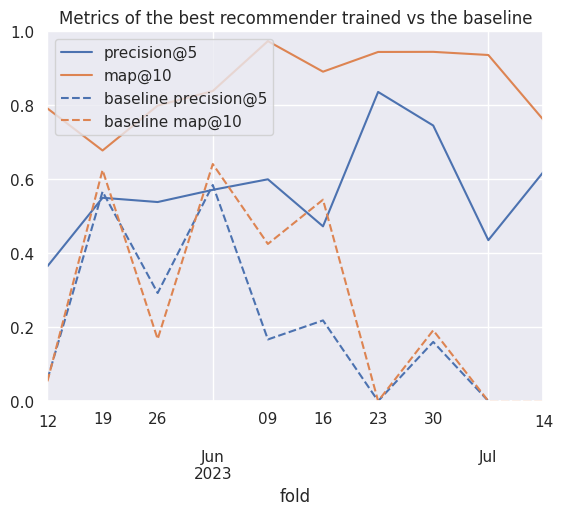

In [38]:
cols2plot = ['precision@5', 'map@10']

ax = best.reset_index().set_index('fold')[cols2plot].plot()
ax.set_ylim(0, 1)

bdf[cols2plot].rename(columns='baseline {}'.format).plot(ax=ax, style='--', color=[l.get_color() for l in ax.lines])

plt.title("Metrics of the best recommender trained vs the baseline")
best[cols2plot].describe()

In [39]:
best[['precision@5', 'ndcg@5', 'precision@10', 'ndcg@10', 'map@5', 'map@10']].mean()

precision@5     0.573444
ndcg@5          0.867191
precision@10    0.421645
ndcg@10         0.909111
map@5           0.820747
map@10          0.855921
dtype: float64

## Realisitc model (repeating hparams)

In [40]:
from pandas.api.types import is_float_dtype

config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]
config_cols2 = config_cols + ['config/iteration']

all_configs = rdf.copy()
display(all_configs)
all_configs['config/fold'] = (pd.to_datetime(all_configs['config/fold']) + pd.tseries.frequencies.to_offset(SPLITS_FREQ)) # .astype(str)

# Leonardo Torres de Quevedo, perdoname por lo que voy a hacer
float_cols = [c for c in config_cols if is_float_dtype(all_configs[c].dtype) ]
all_configs[float_cols] = all_configs[float_cols].astype(str)
all_configs = all_configs.set_index(config_cols)
all_configs_index = all_configs.index

# all_configs_index = pd.MultiIndex.from_frame(all_configs[config_cols].astype(str))[:-1]

# No podemos utilizar los indices "tal cual" pues la coma flotante
# no encaja entre un fold y otro. Así que lo convierto a string
# y luego de nuevo a coma flotante.
# La otra solución sería usar np.isclose, pero habría que programar
# varias lineas y hacer nuestra propia función de búsqueda por cada
# columna o algo así
# O también, en lugar de str, multiplicar por 10^7 (el min. es 10**-7),
# pasar a entero, y luego dividir
aux = rdf.copy()
aux[float_cols] = aux[float_cols].astype(str)
aux = aux.set_index(config_cols)
print("Index intersection:", aux.index.intersection(all_configs_index))
all_realistic = aux.loc[aux.index.intersection(all_configs_index)]
# all_realistic.index = all_realistic.index.set_levels(
#     [ pd.to_numeric(l) for l in realistic.index.levels ]
# )
all_realistic

,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,150,5,0.692679,0.692679,1.056880e-08,0.352941,0.313725,0.305882,0.270588,0.180392,...,0.140076,False,ddc23af8,512,1,2,0.0011,3.881660e-07,60d,2023-05-12
1,150,10,0.690831,0.690831,1.317313e-08,0.352941,0.274510,0.388235,0.270588,0.180392,...,0.277460,False,ddc23af8,512,1,2,0.0011,3.881660e-07,60d,2023-05-12
2,150,15,0.685434,0.685434,1.708068e-08,0.352941,0.313725,0.400000,0.270588,0.180392,...,0.419821,False,ddc23af8,512,1,2,0.0011,3.881660e-07,60d,2023-05-12
3,150,20,0.675574,0.675574,2.451436e-08,0.352941,0.313725,0.400000,0.270588,0.180392,...,0.610360,False,ddc23af8,512,1,2,0.0011,3.881660e-07,60d,2023-05-12
4,150,25,0.662409,0.662409,3.405367e-08,0.352941,0.313725,0.400000,0.270588,0.180392,...,0.760721,False,ddc23af8,512,1,2,0.0011,3.881660e-07,60d,2023-05-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,32,180,0.019655,0.003848,1.580730e-02,0.600000,0.533333,0.480000,0.480000,0.500000,...,4.897208,False,88018544,32,34,2,0.0091,7.608004e-04,60d,2023-07-14
36,32,185,0.020025,0.004108,1.591653e-02,0.400000,0.466667,0.440000,0.500000,0.500000,...,5.033078,False,88018544,32,34,2,0.0091,7.608004e-04,60d,2023-07-14
37,32,190,0.018911,0.003356,1.555559e-02,0.600000,0.533333,0.480000,0.510000,0.500000,...,5.173160,False,88018544,32,34,2,0.0091,7.608004e-04,60d,2023-07-14
38,32,195,0.019756,0.004042,1.571398e-02,0.700000,0.500000,0.500000,0.510000,0.500000,...,5.320353,False,88018544,32,34,2,0.0091,7.608004e-04,60d,2023-07-14


Index intersection: MultiIndex([(1024,   1, 1, '0.0029000000000000002', ...),
            ( 512,  26, 2,                '0.6694', ...),
            ( 512, 665, 3,                '0.0092', ...),
            (  32, 217, 2,   '0.47850000000000004', ...),
            ( 128,  96, 2,                '0.0784', ...),
            ( 512,  86, 2, '0.0006000000000000001', ...),
            ( 512, 332, 3,                '0.4863', ...),
            (  32,  97, 4, '0.0021000000000000003', ...),
            ( 128, 241, 2, '0.0017000000000000001', ...),
            (  64,  27, 2,                '0.2056', ...),
            ...
            (1024,   1, 1, '0.0029000000000000002', ...),
            ( 128,  32, 4,  '0.015000000000000001', ...),
            ( 128,  96, 2,                '0.0784', ...),
            ( 256,  86, 3,                '0.0002', ...),
            ( 128, 241, 2, '0.0017000000000000001', ...),
            ( 512,  26, 2,                '0.6694', ...),
            ( 512, 121, 3,          

real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2             config/window_size config/fold                    
1024              1                    1                  0.0029000000000000002 0.0006990705221345083 21d                2023-05-19                43   
                                                                                                                         2023-05-19                43   
                                                                                                                         2023-05-19                43   
                                                                                                                         2023-05-19                43   
                                                                                                                         2023-05-19                43   
...                                                                                                                                               ...   
32                34                   2                  0.0091                0.0007608003684554223 60d                2023-07-14                32   
                                                                                                                         2023-07-14                32   
                                                                                                                         2023-07-14                32   
                                                                                                                         2023-07-14                32   
                                                                                                                         2023-07-14                32   

                                                                                                                                      config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2             config/window_size config/fold                     
1024              1                    1                  0.0029000000000000002 0.0006990705221345083 21d                2023-05-19                  5   
                                                                                                                         2023-05-19                 10   
                                                                                                                         2023-05-19                 15   
                                                                                                                         2023-05-19                 20   
                                                                                                                         2023-05-19                 25   
...                                                                                                                                                ...   
32                34                   2                  0.0091                0.0007608003684554223 60d                2023-07-14                180   
                                                                                                                         2023-07-14                185   
                                                                                                                         2023-07-14                190   
                                                                                                                         2023-07-14                195   
                                                                                                                         2023-07-14                200   

                                                                                                                                          los

In [41]:
def bestByFold(df):
    idx = df[OPTIM_METRIC].idxmax()
    return df.loc[idx]

best_configs = (
    all_configs.loc[all_configs.index.intersection(all_realistic.index)]
    .reset_index()
    .groupby("config/fold")
    .apply(bestByFold)
    .set_index(config_cols)
    # .rename(columns="best_{}".format)
)
best_configs

/tmp/ipykernel_639006/543710717.py:9: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,,,,,,,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_rec,time_total_train,time_total_test,done,trial_id
config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold,,,,,,,,,,,,,,,,,,,,,
32,34,2,0.0091,0.0007608003684554223,60d,2023-05-19,32,100,0.016633,0.003499,1.313331e-02,0.705882,0.450980,0.364706,0.270588,0.180392,...,0.707051,0.764744,0.851282,0.851282,0.851282,0.001441,4.075446,2.707413,False,66aee4d3
16,1,1,0.0007,0.001438399741730001,30d,2023-05-26,16,190,0.350844,0.346792,4.051511e-03,0.583333,0.388889,0.450000,0.441667,0.338889,...,0.523760,0.627557,0.830600,0.849118,0.849118,0.001628,8.197061,5.748551,False,c89a8db6
512,447,3,0.0008,0.00012930138476387965,60d,2023-06-02,151,165,0.017074,0.013558,3.516171e-03,0.846154,0.589744,0.492308,0.407692,0.271795,...,0.566667,0.669697,0.760606,0.760606,0.760606,0.001817,2.078839,4.495390,False,9869ec4f
128,368,3,0.0002,0.001000370307954212,90d,2023-06-09,128,155,0.085985,0.072348,1.363658e-02,0.857143,0.571429,0.571429,0.371429,0.247619,...,0.600275,0.756868,0.846154,0.846154,0.846154,0.001534,2.175272,4.071941,False,c33d014c
16,352,1,0.1413,0.0008250397225727167,10YE,2023-06-16,16,200,10.414774,2.730236,7.684538e+00,0.916667,0.694444,0.633333,0.358333,0.238889,...,0.700000,0.918182,0.963636,0.963636,0.963636,0.002233,213.806187,6.082474,True,1f3d6b5f
512,332,3,0.4863,0.0022115851672258576,10YE,2023-06-23,512,90,0.911636,0.166357,7.452789e-01,0.818182,0.515152,0.400000,0.363636,0.327273,...,0.640000,0.682857,0.754286,0.811429,0.811429,0.002643,3.732782,3.023687,False,eccb0ead
64,12,4,0.21880000000000002,2.900739027817296e-07,21d,2023-06-30,35,125,0.002544,0.002504,4.039339e-05,1.000000,0.878788,0.763636,0.718182,0.478788,...,0.445455,0.581818,0.846970,0.846970,0.846970,0.001292,0.808249,3.226531,False,10c964c9
16,4,2,0.0002,6.252469025005197e-07,90d,2023-07-07,16,45,0.388875,0.388874,8.210642e-07,1.000000,0.787879,0.745455,0.481818,0.321212,...,0.573593,0.758009,0.887879,0.887879,0.887879,0.001360,3.987987,1.133702,False,fdbfafad
128,96,2,0.0784,4.9242449710696274e-05,21d,2023-07-14,23,30,0.004776,0.000164,4.611287e-03,0.882353,0.588235,0.435294,0.217647,0.145098,...,0.877778,0.977778,0.977778,0.977778,0.977778,0.002508,0.546487,0.826618,False,326018ab


In [42]:
best_realistic = all_realistic.join(best_configs.rename(columns="best_{}".format), how='right')

# Display the configs, to see that nothing is missing
display(best_realistic.groupby(best_realistic.index).size())

# First, do the "early stopping" (keep only the ones that are the same iterations or less)
best_realistic = best_realistic[best_realistic['config/iteration'] <= best_realistic['best_config/iteration']]
# Now, lets keep just the one with the best iteration
best_realistic = (
    best_realistic.sort_values('config/iteration')
    .groupby('config/fold')
    .tail(1)
    .sort_index()
    .reset_index()
    .set_index('config/fold')
    .sort_index()
)
best_realistic

(16, 1, 1, 0.0007, 0.001438399741730001, 30d, 2023-05-26 00:00:00)                   40
(16, 4, 2, 0.0002, 6.252469025005197e-07, 90d, 2023-07-07 00:00:00)                  40
(16, 352, 1, 0.1413, 0.0008250397225727167, 10YE, 2023-06-16 00:00:00)               40
(32, 34, 2, 0.0091, 0.0007608003684554223, 60d, 2023-05-19 00:00:00)                 40
(64, 12, 4, 0.21880000000000002, 2.900739027817296e-07, 21d, 2023-06-30 00:00:00)    40
(128, 96, 2, 0.0784, 4.9242449710696274e-05, 21d, 2023-07-14 00:00:00)               40
(128, 368, 3, 0.0002, 0.001000370307954212, 90d, 2023-06-09 00:00:00)                40
(512, 332, 3, 0.4863, 0.0022115851672258576, 10YE, 2023-06-23 00:00:00)              40
(512, 447, 3, 0.0008, 0.00012930138476387965, 60d, 2023-06-02 00:00:00)              80
dtype: int64

,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,real_batch_size,config/iteration,loss,mf_loss,...,best_r-precision@3,best_r-precision@5,best_r-precision@10,best_r-precision@15,best_r-precision@100,best_time_rec,best_time_total_train,best_time_total_test,best_done,best_trial_id
config/fold,,,,,,,,,,,,,,,,,,,,,
2023-05-19,32,34,2,0.0091,0.0007608003684554223,60d,32,100,0.016434,0.003251,...,0.707051,0.764744,0.851282,0.851282,0.851282,0.001441,4.075446,2.707413,False,66aee4d3
2023-05-26,16,1,1,0.0007,0.001438399741730001,30d,16,190,0.367307,0.363337,...,0.523760,0.627557,0.830600,0.849118,0.849118,0.001628,8.197061,5.748551,False,c89a8db6
2023-06-02,512,447,3,0.0008,0.00012930138476387965,60d,142,165,0.015851,0.012373,...,0.566667,0.669697,0.760606,0.760606,0.760606,0.001817,2.078839,4.495390,False,9869ec4f
2023-06-09,128,368,3,0.0002,0.001000370307954212,90d,128,155,0.081896,0.068285,...,0.600275,0.756868,0.846154,0.846154,0.846154,0.001534,2.175272,4.071941,False,c33d014c
2023-06-16,16,352,1,0.1413,0.0008250397225727167,10YE,16,200,11.607062,3.800474,...,0.700000,0.918182,0.963636,0.963636,0.963636,0.002233,213.806187,6.082474,True,1f3d6b5f
2023-06-23,512,332,3,0.4863,0.0022115851672258576,10YE,512,90,1.325490,0.235884,...,0.640000,0.682857,0.754286,0.811429,0.811429,0.002643,3.732782,3.023687,False,eccb0ead
2023-06-30,64,12,4,0.21880000000000002,2.900739027817296e-07,21d,27,125,0.000057,0.000019,...,0.445455,0.581818,0.846970,0.846970,0.846970,0.001292,0.808249,3.226531,False,10c964c9
2023-07-07,16,4,2,0.0002,6.252469025005197e-07,90d,16,45,0.608485,0.608485,...,0.573593,0.758009,0.887879,0.887879,0.887879,0.001360,3.987987,1.133702,False,fdbfafad
2023-07-14,128,96,2,0.0784,4.9242449710696274e-05,21d,27,30,0.004302,0.000257,...,0.877778,0.977778,0.977778,0.977778,0.977778,0.002508,0.546487,0.826618,False,326018ab


In [43]:
paths.save_model_results(
    clean_results(best_realistic.reset_index().copy())[0],
    'lightgcn-best-test',
    ORG_NAME,
    SPLITS_FREQ,
    SPLITS_NORMALIZE,
    K_RECOMMENDATIONS,
)

Saved dataframe into /home/daviddavo/recsys4daos/data/output/Aura Finance/models/lightgcn-best-test_7d_normalize.parquet


,precision@5,map@10
count,9.000000,9.000000
mean,0.489907,0.598302
std,0.133996,0.148707
min,0.283333,0.352584
25%,0.415385,0.505488
50%,0.460000,0.620915
75%,0.533333,0.668213
max,0.709091,0.847532


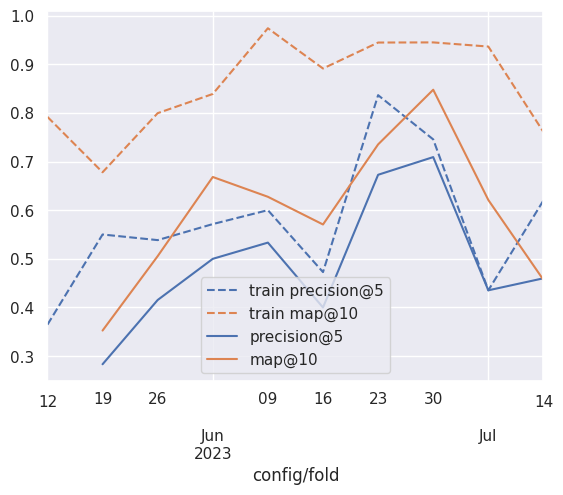

In [44]:
_toplot = best_realistic.copy().sort_index()
_toplot.index = pd.to_datetime(_toplot.index)

ax = best.reset_index().set_index('fold')[cols2plot].rename(columns='train {}'.format).plot(style='--', color=[l.get_color() for l in ax.lines])
# plt.xticks(range(10))
# bdf[cols2plot].rename(columns='baseline {}'.format).reset_index(drop=True).plot(ax=ax, style=':', color=[l.get_color() for l in ax.lines])

_toplot[cols2plot].plot(ax=ax)
# ax.set_ylim(0, 1)

_toplot[cols2plot].describe()

In [45]:
best_realistic.index.min()

Timestamp('2023-05-19 00:00:00')

In [46]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-05-12,0.294118,0.098039,0.058824,0.029412,0.019608,0.002941,0.294118,0.138023,0.107407,0.092192,...,0.053431,0.053431,0.053431,0.181667,0.181667,0.181667,0.181667,0.181667,0.181667,0.126327
2023-05-19,0.583333,0.555556,0.566667,0.458333,0.322222,0.048333,0.583333,0.608007,0.699209,0.737214,...,0.949769,0.974306,0.974306,0.264853,0.445238,0.594147,0.755258,0.765675,0.765675,0.128861
2023-05-26,0.153846,0.282051,0.292308,0.146154,0.097436,0.014615,0.153846,0.267724,0.323910,0.274000,...,0.321795,0.321795,0.321795,0.100000,0.261905,0.356250,0.356250,0.356250,0.356250,0.132081
2023-06-02,0.384615,0.589744,0.584615,0.376923,0.251282,0.037692,0.357143,0.585016,0.660655,0.695388,...,0.979396,0.979396,0.979396,0.153571,0.430357,0.569643,0.673214,0.673214,0.673214,0.130645
2023-06-09,0.833333,0.277778,0.166667,0.083333,0.055556,0.008333,0.833333,0.567973,0.502913,0.493774,...,0.425000,0.425000,0.425000,0.510000,0.510000,0.510000,0.510000,0.510000,0.510000,0.129407
2023-06-16,0.818182,0.363636,0.218182,0.109091,0.072727,0.010909,0.818182,0.714194,0.651951,0.610800,...,0.557143,0.557143,0.557143,0.609524,0.612857,0.612857,0.612857,0.612857,0.612857,0.126719
2023-06-23,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.073857
2023-06-30,0.800000,0.266667,0.160000,0.080000,0.053333,0.008000,0.727273,0.367452,0.296478,0.267258,...,0.191429,0.191429,0.191429,0.239286,0.239286,0.239286,0.239286,0.239286,0.239286,0.127027
2023-07-07,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.075259


In [47]:
_PERFECT_NAME = 'Ground Truth'
_LEAK_NAME = 'Leaky GNN'
CAT_ORDER = [_PERFECT_NAME, _LEAK_NAME, 'GNN', 'OpenPop']

def _get_toplot_table(metrics2plot=cols2plot, oracle=True, perfect=None, common_only=False):
    if perfect is None:
        perfect = metrics2plot
    
    # _toplot = best_realistic.copy()
    # _toplot.index = pd.to_numeric(_toplot.index)
    # _toplot['fold'] = _toplot.index

    _first_real_fold_idx = best_realistic.index.min()
    
    _toplot_real = best_realistic[metrics2plot].copy()
    _toplot_real['fold'] = pd.to_datetime(_toplot_real.index) # .astype(int)
    _toplot_real['rec'] = 'GNN'

    _toplot_base = bdf[metrics2plot].copy()
    # fold2str = _toplot_base.index.strftime('%G-W%V')
    # _toplot_base['fold'] = range(len(_toplot_base))
    _toplot_base['fold'] = pd.to_datetime(_toplot_base.index)
    _toplot_base['rec'] = 'OpenPop'

    # _colsbest = map("best_{}".format, _cols)
    if oracle:
        _toplot_best = best.reset_index().set_index('fold')[metrics2plot].copy() # [_colsbest].rename(columns=lambda x: x.split("_", 1)[-1])
        _toplot_best['fold'] = _toplot_best.index
        _toplot_best['rec'] = _LEAK_NAME
    else:
        _toplot_best = None
        _toplot_base = _toplot_base[_toplot_base['fold'] >= _first_real_fold_idx]
        _toplot_real = _toplot_real[_toplot_real['fold'] >= _first_real_fold_idx]

    if perfect:
        _toplot_perfect = pdf[perfect].copy()
        _toplot_perfect['fold'] = pd.to_datetime(_toplot_perfect.index)
        _toplot_perfect['rec'] = _PERFECT_NAME
        # Make same len as baseline
        # _toplot_perfect = _toplot_perfect.iloc[-len(_toplot_base):]
        _toplot_perfect = _toplot_perfect.loc[_toplot_base.index]
        assert _toplot_perfect.index.equals(_toplot_base.index)
    else:
        _toplot_perfect = None
        
    _toplot = (
        pd.concat((
            _toplot_real, 
            _toplot_best,
            _toplot_base,
            _toplot_perfect,
        ), ignore_index=True)
        .melt(id_vars=['fold', 'rec'], value_vars=metrics2plot, var_name='metric')
    )

    assert pd.api.types.is_datetime64_any_dtype(_toplot['fold'].dtype), "Fold column should be datetime"
    assert not (_toplot['fold'].isna()).any()
    
    _toplot['rec'] = pd.Categorical(_toplot['rec'], CAT_ORDER)
    _toplot['fold_week'] = _toplot['fold'].dt.strftime('%G-W%V') # fold2str[_toplot['fold']]

    return _toplot.sort_values('fold')

_tablecols = ['precision@5', 'precision@10', 'recall@5', 'recall@10', 'map@5', 'map@10', 'ndcg@5', 'ndcg@10']
_table = _get_toplot_table(_tablecols)
# Skip the first fold so everyone has 9 folds and metrics are consistent
_table = _table[_table['fold'] >= best_realistic.index.min()]
print(_table.groupby(['rec', 'metric'])['value'].mean().unstack(level=-1)[_tablecols].rename(
    index={
        'Perfect': 'Ground Truth',
        'realistic': 'GNN'
    }
).style.format(precision=2).to_latex())
_table.groupby(['rec', 'metric']).describe()

\begin{tabular}{lrrrrrrrr}
metric & precision@5 & precision@10 & recall@5 & recall@10 & map@5 & map@10 & ndcg@5 & ndcg@10 \\
rec &  &  &  &  &  &  &  &  \\
Ground Truth & 0.67 & 0.45 & 0.86 & 0.98 & 1.00 & 1.00 & 1.00 & 1.00 \\
Leaky GNN & 0.60 & 0.44 & 0.77 & 0.96 & 0.83 & 0.86 & 0.88 & 0.92 \\
GNN & 0.49 & 0.43 & 0.54 & 0.90 & 0.52 & 0.60 & 0.59 & 0.70 \\
OpenPop & 0.22 & 0.14 & 0.33 & 0.38 & 0.30 & 0.29 & 0.35 & 0.34 \\
\end{tabular}



/tmp/ipykernel_639006/3868849439.py:68: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipykernel_639006/3868849439.py:74: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



fold                                            \
                          count                 mean                  min   
rec          metric                                                         
Ground Truth map@10           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             map@5            9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@10          9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@5           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@10     9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@5      9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@10        9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@5         9  2023-06-16 00:00:00  2023-05-19 00:00:00   
Leaky GNN    map@10           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             map@5            9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@10          9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@5           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@10     9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@5      9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@10        9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@5         9  2023-06-16 00:00:00  2023-05-19 00:00:00   
GNN          map@10           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             map@5            9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@10          9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@5           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@10     9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@5      9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@10        9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@5         9  2023-06-16 00:00:00  2023-05-19 00:00:00   
OpenPop      map@10           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             map@5            9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@10          9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             ndcg@5           9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@10     9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             precision@5      9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@10        9  2023-06-16 00:00:00  2023-05-19 00:00:00   
             recall@5         9  2023-06-16 00:00:00  2023-05-19 00:00:00   

                                                                     \
                                           25%                  50%   
rec          metric                                                   
Ground Truth map@10        2023-06-02 00:00:00  2023-06-16 00:00:00   
             map@5         2023-06-02 00:00:00  2023-06-16 00:00:00   
             ndcg@10       2023-06-02 00:00:00  2023-06-16 00:00:00   
             ndcg@5        2023-06-02 00:00:00  2023-06-16 00:00:00   
             precision@10  2023-06-02 00:00:00  2023-06-16 00:00:00   
             precision@5   2023-06-02 00:00:00  2023-06-16 00:00:00   
             recall@10     2023-06-02 00:00:00  2023-06-16 00:00:00   
             recall@5      2023-06-02 00:00:00  2023-06-16 00:00:00   
Leaky GNN    map@10        2023-06-02 00:00:00  2023-06-16 00:00:00   
             map@5         2023-06-02 00:00:00  2023-06-16 00:00:00   
             ndcg@10       2023-06-02 00:00:00  2023-06-16 00:00:00   
             ndcg@5        2023-06-02 00:00:00  2023-06-16 00:00:00   
             precision@10  2023-06-02 00:00:00  2023-06-16 00:00:00   
             precision@5   2023-06-02 00:00:00  2023-06-16 00:00:00   
             recall@10     2023-06-02 00:00:00  2023-06-16 00:00:00   
             recall@5      2023-06-02 00:00:00  2023-

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



count      mean       std       min       25%  \
rec          metric                                                       
Ground Truth map@10        10.0  1.000000  0.000000  1.000000  1.000000   
             precision@5   10.0  0.647471  0.145349  0.435294  0.593506   
Leaky GNN    map@10        10.0  0.855921  0.097595  0.677914  0.793646   
             precision@5   10.0  0.573444  0.139907  0.364706  0.489161   
GNN          map@10         9.0  0.598302  0.148707  0.352584  0.505488   
             precision@5    9.0  0.489907  0.133996  0.283333  0.415385   
OpenPop      map@10        10.0  0.264861  0.267796  0.000000  0.013358   
             precision@5   10.0  0.204726  0.219505  0.000000  0.014706   

                               50%       75%       max  
rec          metric                                     
Ground Truth map@10       1.000000  1.000000  1.000000  
             precision@5  0.648077  0.721667  0.909091  
Leaky GNN    map@10       0.864991  0.942455  0.973889  
             precision@5  0.560714  0.615000  0.836364  
GNN          map@10       0.620915  0.668213  0.847532  
             precision@5  0.460000  0.533333  0.709091  
OpenPop      map@10       0.179528  0.514854  0.641287  
             precision@5  0.163333  0.273776  0.584615

Cannot show ipywidgets in text

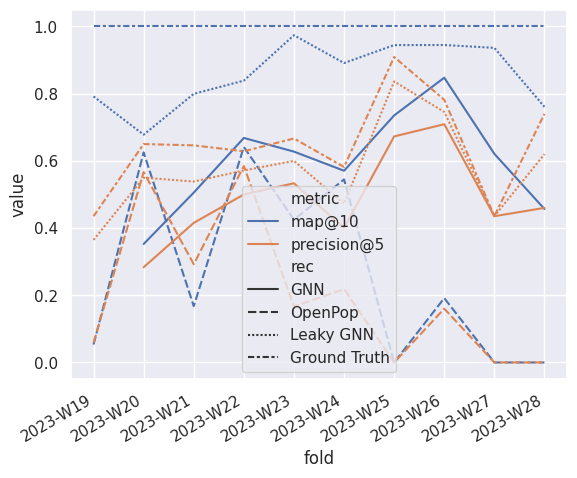

In [48]:
def plot_gnn_results(metrics2plot=cols2plot, oracle=False, perfect=None, common_only=False):
    _toplot = _get_toplot_table(metrics2plot, oracle, perfect)

    if common_only:
        _toplot = _toplot[_toplot['fold'] >= best_realistic.index.min()]

    ax = sns.lineplot(
        _toplot, x='fold_week', y='value', 
        hue='metric' if len(metrics2plot) > 1 else None, 
        style='rec',
        style_order=['GNN', 'OpenPop', _LEAK_NAME, _PERFECT_NAME],
    )
    ax.set_xlabel('fold')
    
    if len(metrics2plot) == 1:
        ax.set_ylabel(metrics2plot[0])
        ax.legend_.set_title(None)

    # ax.set_xticks(ax.get_xticks()[1:-1], _toplot_base.index.strftime('%G-W%V'), rotation=30, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')

    display(_toplot.groupby(['rec', 'metric'])['value'].describe())
    # print(_toplot.groupby(['rec', 'metric'])['value'].describe()[['mean', 'std', '50%', 'min', 'max']].to_html())

    return ax

ax = plot_gnn_results(oracle=True) # perfect=['precision@5'])
download_matplotlib(ax.figure, '09_gnn_results.pdf')

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,9.0,0.671046,0.132343,0.435294,0.628571,0.650000,0.740000,0.909091
GNN,precision@5,9.0,0.489907,0.133996,0.283333,0.415385,0.460000,0.533333,0.709091
OpenPop,precision@5,9.0,0.220938,0.226382,0.000000,0.000000,0.166667,0.292308,0.584615


Cannot show ipywidgets in text

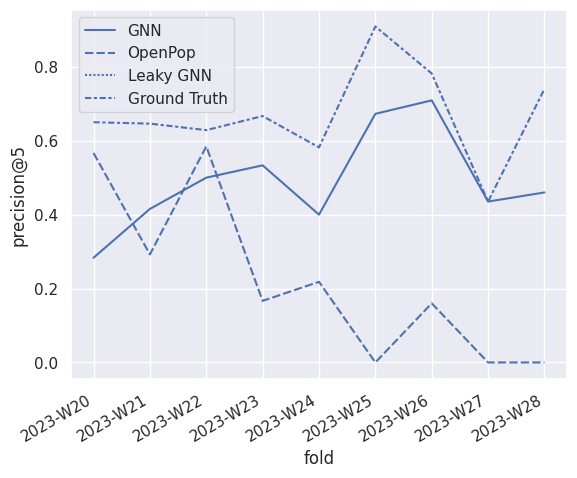

In [49]:
ax = plot_gnn_results(['precision@5'])
ax.figure.savefig('../figures/09_gnn_results_precision_5.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_precision_5.pdf')

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,9.0,0.671046,0.132343,0.435294,0.628571,0.650000,0.740000,0.909091
Leaky GNN,precision@5,9.0,0.596637,0.126369,0.435294,0.538462,0.571429,0.620000,0.836364
GNN,precision@5,9.0,0.489907,0.133996,0.283333,0.415385,0.460000,0.533333,0.709091
OpenPop,precision@5,9.0,0.220938,0.226382,0.000000,0.000000,0.166667,0.292308,0.584615


Cannot show ipywidgets in text

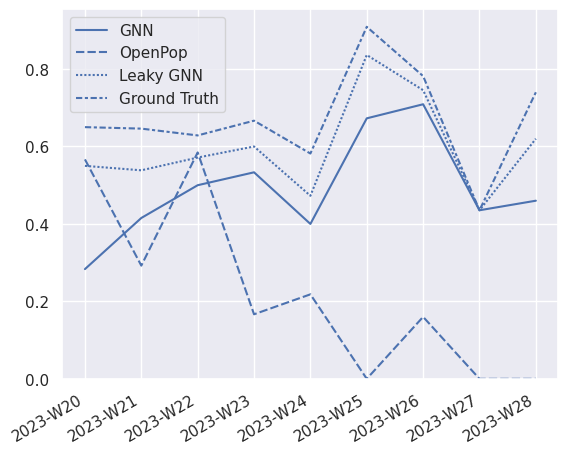

In [50]:
ax = plot_gnn_results(['precision@5'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_precision_5_leaky.pdf')

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,map@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
GNN,map@10,9.0,0.598302,0.148707,0.352584,0.505488,0.620915,0.668213,0.847532
OpenPop,map@10,9.0,0.288353,0.272893,0.000000,0.000000,0.191429,0.544805,0.641287


Cannot show ipywidgets in text

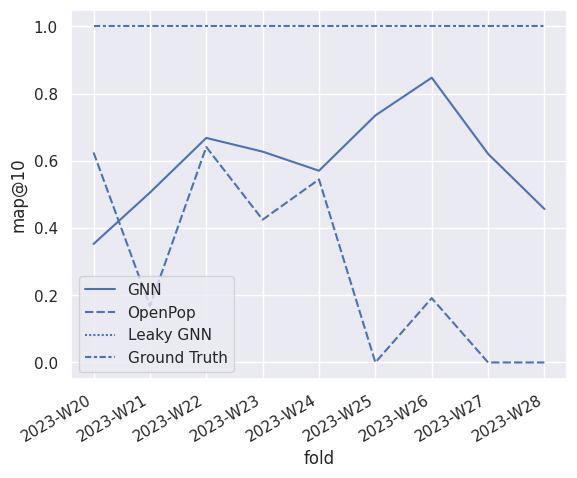

In [51]:
ax = plot_gnn_results(['map@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_map_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_map_10.pdf')

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
GNN,ndcg@10,9.0,0.699078,0.125687,0.501298,0.653815,0.717533,0.767235,0.902409
OpenPop,ndcg@10,9.0,0.342048,0.303617,0.000000,0.000000,0.274000,0.610800,0.737214


Cannot show ipywidgets in text

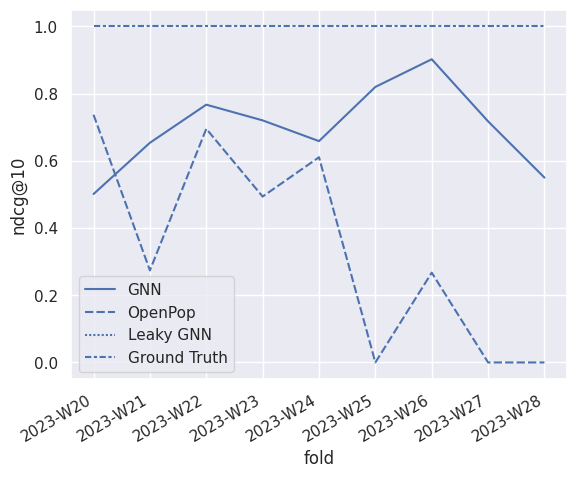

In [52]:
ax = plot_gnn_results(['ndcg@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_ndcg_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_ndcg_10.pdf')

/tmp/ipykernel_639006/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_639006/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,9.0,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Leaky GNN,ndcg@10,9.0,0.915123,0.071174,0.780296,0.876844,0.938260,0.975484,0.990140
GNN,ndcg@10,9.0,0.699078,0.125687,0.501298,0.653815,0.717533,0.767235,0.902409
OpenPop,ndcg@10,9.0,0.342048,0.303617,0.000000,0.000000,0.274000,0.610800,0.737214


Cannot show ipywidgets in text

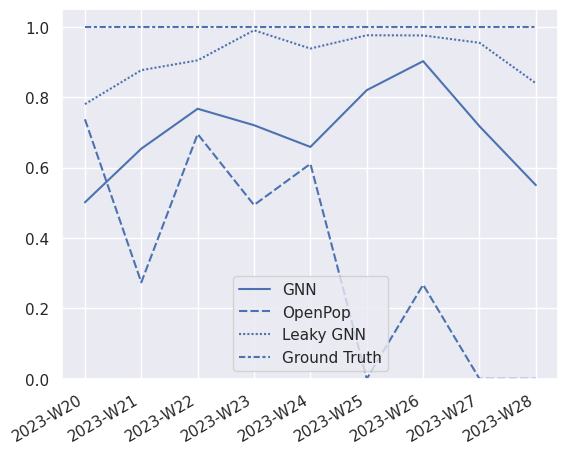

In [53]:
ax = plot_gnn_results(['ndcg@10'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_ndcg_10_leaky.pdf')